# Exercise 12 Image Processing

ImageAI : Object Detection

Library ImageAI provides very convinient and powerful methods to detect objects in the image. In order to start detecting objects the trained models should be uploaded. We will use two models, i.e. RetinaNet and YOLO and compare them:

To get started we istall computer vision library OpenCV, and the library ImageAI that allows to detect objects in the image, and the library of machine learning TensorFlow and a neuronet library Keras of the specified release :)

In [ ]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
!pip install -q tensorflow==2.3.1
!pip install -q tensorflow-gpu==2.3.1
!git clone https://github.com/dvolchek/YOLOv3-TensorFlow-2.x.git
%cd YOLOv3-TensorFlow-2.x
!wget -P model_data https://pjreddie.com/media/files/yolov3.weights

ERROR: Could not find a version that satisfies the requirement tensorflow==2.3.1 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.11.1, 2.12.0rc0, 2.12.0rc1, 2.12.0, 2.13.0rc0)
ERROR: No matching distribution found for tensorflow==2.3.1
ERROR: Could not find a version that satisfies the requirement tensorflow-gpu==2.3.1 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.12.0)
ERROR: No matching distribution found for tensorflow-gpu==2.3.1
Cloning into 'YOLOv3-TensorFlow-2.x'...
remote: Enumerating objects: 81, done.
remote: Counting objects: 100% (81/81), done.
remote: Compressing objects: 100% (76/76), done.
remote: Total 81 (d

In [ ]:
import detection_demo

In [ ]:
detection_demo.detect('/content/Image-09.jpeg')

1/1 [==============================] - 4s 4s/step


The image can be viewed in the project folder, or displayed on the screen in notebook.
It can be seen that there are 5 people in the image. The model successfully coped with their detection. Other objects like laptop, cup, etc. are not of interest to us)

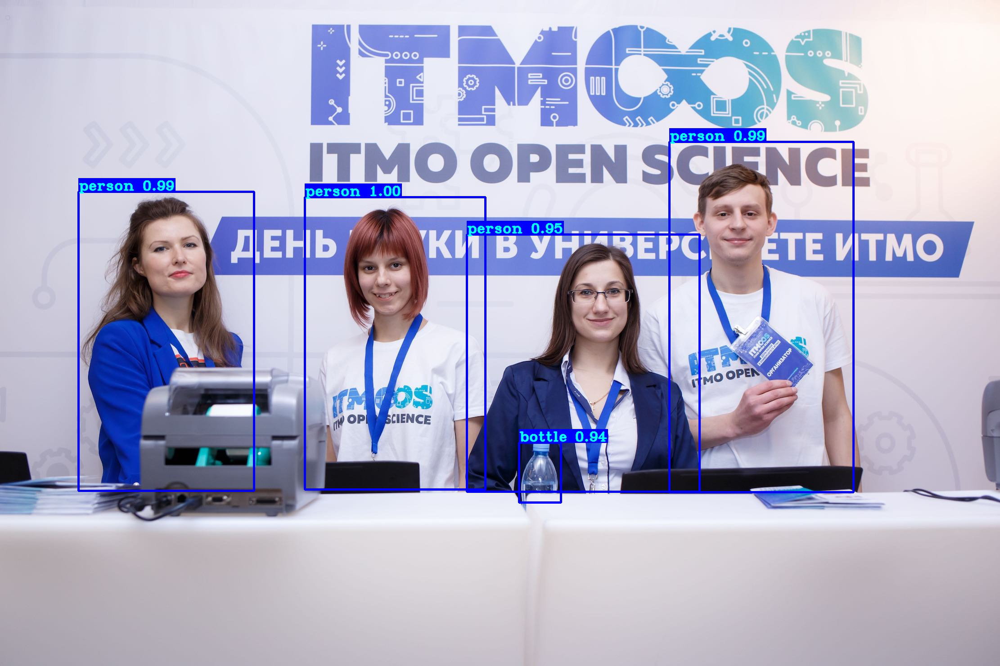

In [ ]:
from PIL import Image
image = Image.open('/content/detected.jpg')
image

## 2. Recognize people in the images

For the given photos, recognize people in the images using a pre-trained YOLO model with a cut-off threshold of 50 percent.

In [ ]:
!pip install imageai

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.8/69.8 kB 2.4 MB/s eta 0:00:00


In [ ]:
# from imageai.Detection import ObjectDetection

In [ ]:
# detector = ObjectDetection()

# # To use YOLOv3 model, change the rows that after specifying the model type to:
# detector.setModelTypeAsYOLOv3()
# detector.setModelPath("yolo.h5")
# detector.loadModel()

ValueError: ignored

In [ ]:
def detectPeopleAndPrint(number):
    print(f"Image #{number}")
    if number == 10:
        detection_demo.detect(f"/content/train/Image-{number}.jpeg")
    else:
        detection_demo.detect(f"/content/train/Image-0{number}.jpeg")

    # from PIL import Image
    image = Image.open('/content/detected.jpg')
    image.show()

Image #1
1/1 [==============================] - 3s 3s/step


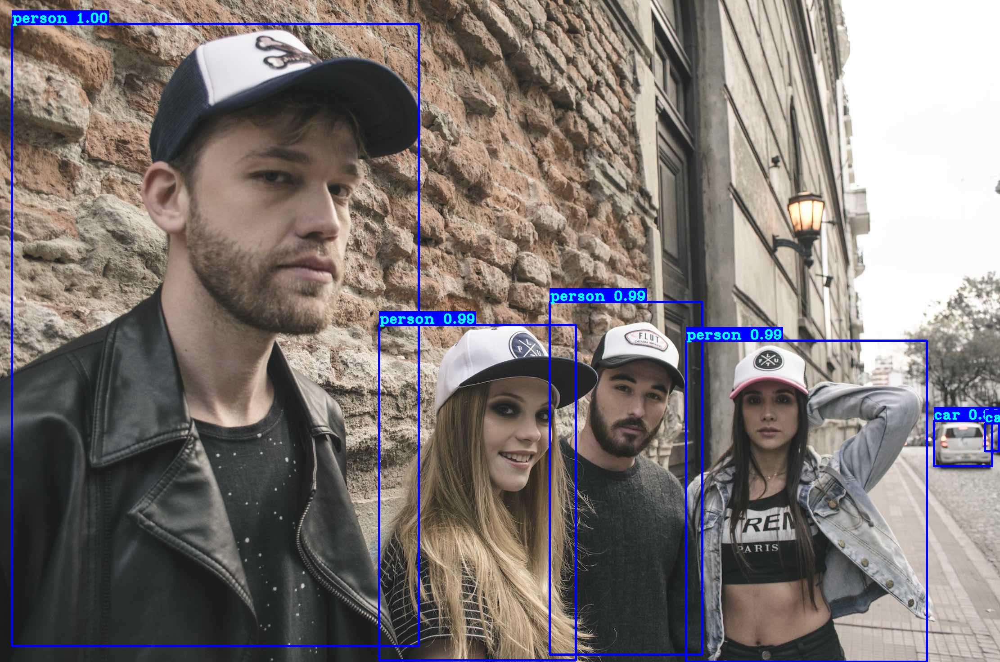

In [ ]:
detectPeopleAndPrint(1)

Image #2
1/1 [==============================] - 3s 3s/step


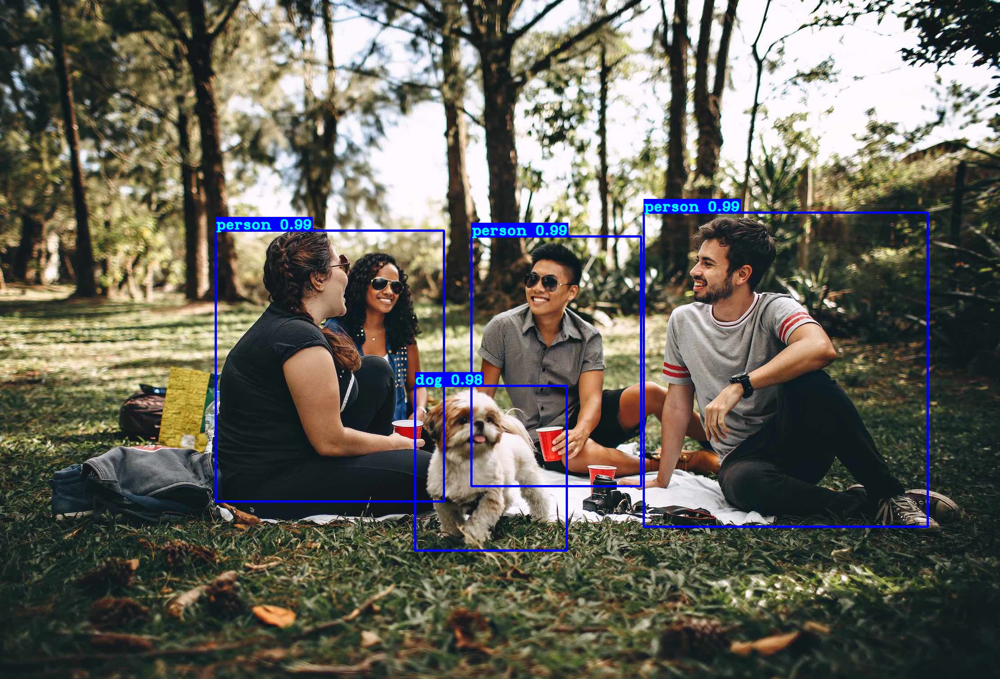

In [ ]:
detectPeopleAndPrint(2)

Image #3
1/1 [==============================] - 3s 3s/step


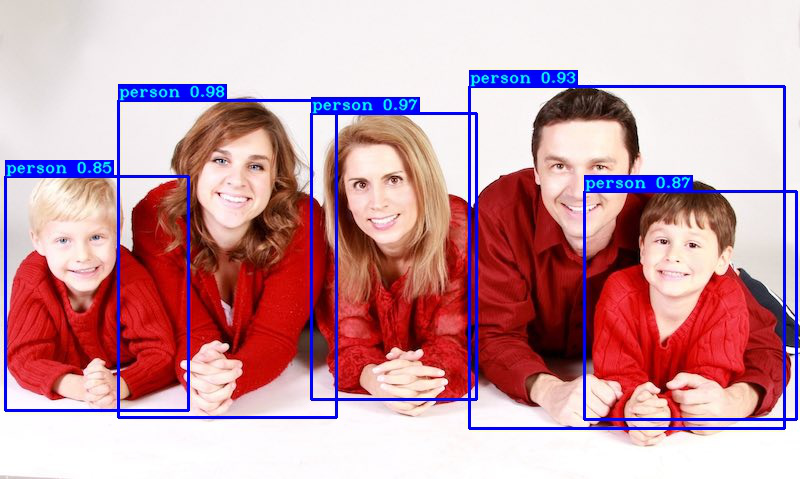

In [ ]:
detectPeopleAndPrint(3)

Image #4
1/1 [==============================] - 4s 4s/step


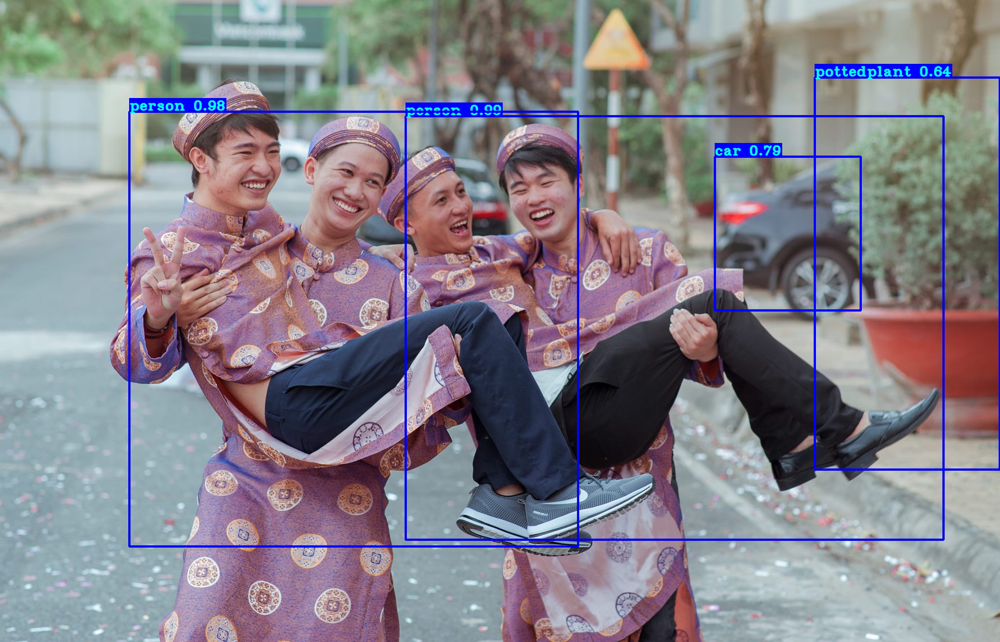

In [ ]:
detectPeopleAndPrint(4)

Image #5
1/1 [==============================] - 5s 5s/step


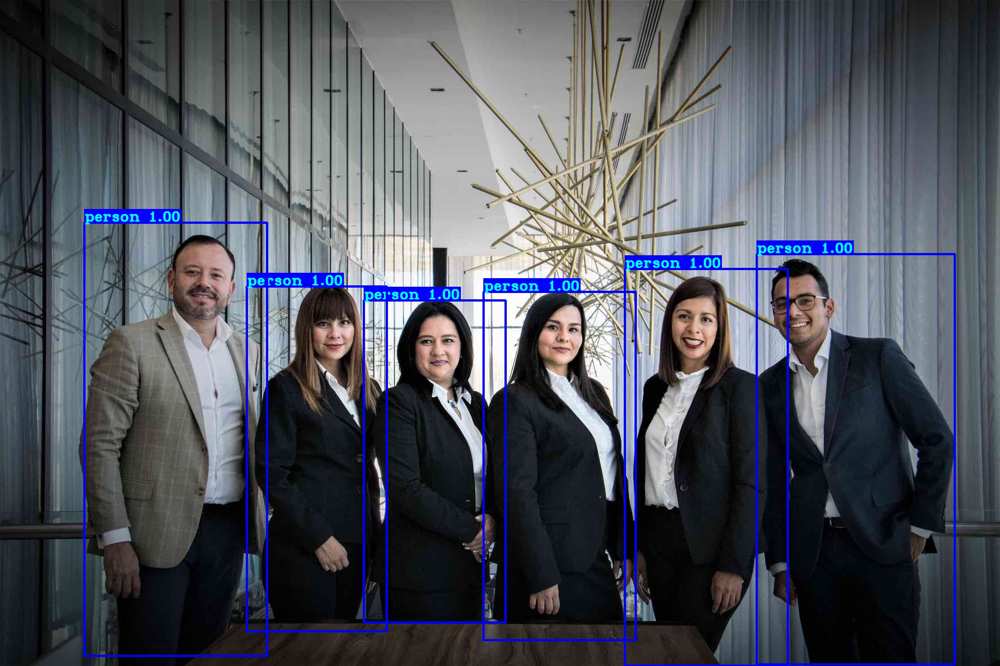

In [ ]:
detectPeopleAndPrint(5)

Image #6
1/1 [==============================] - 4s 4s/step


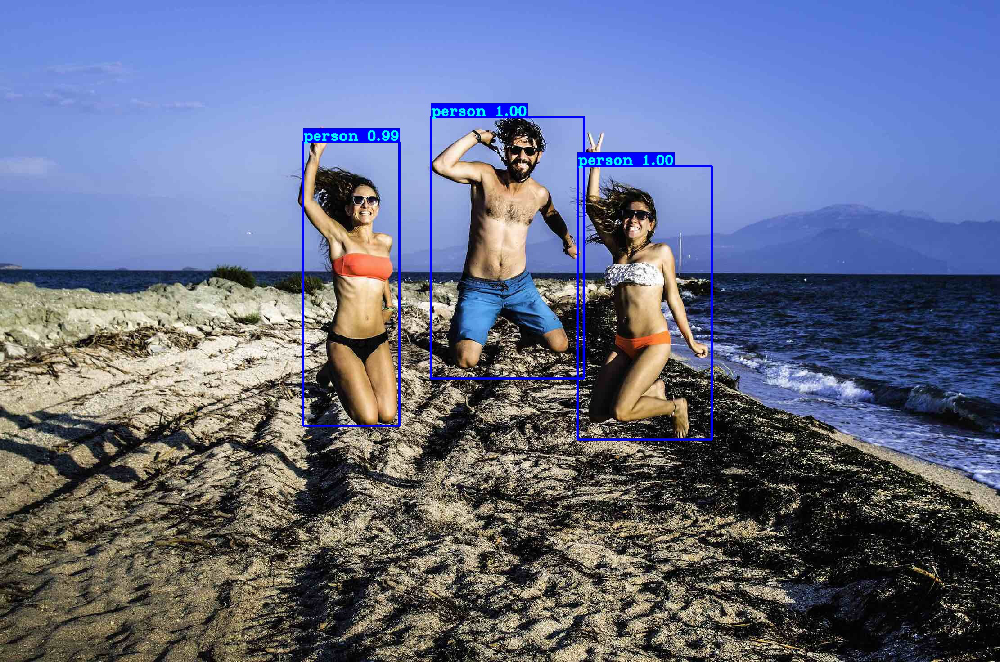

In [ ]:
detectPeopleAndPrint(6)

Image #7
1/1 [==============================] - 5s 5s/step


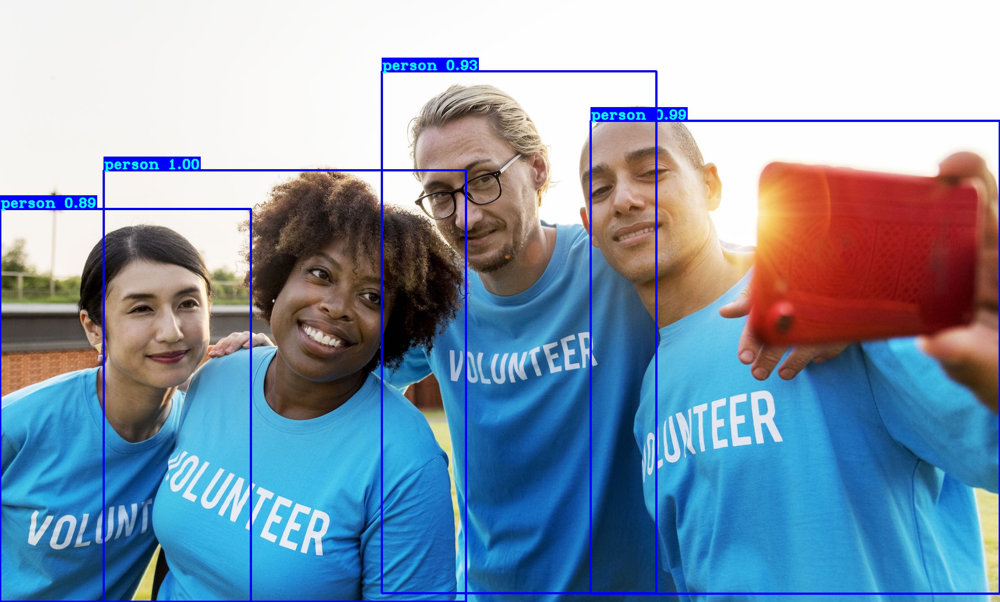

In [ ]:
detectPeopleAndPrint(7)

Image #8
1/1 [==============================] - 3s 3s/step


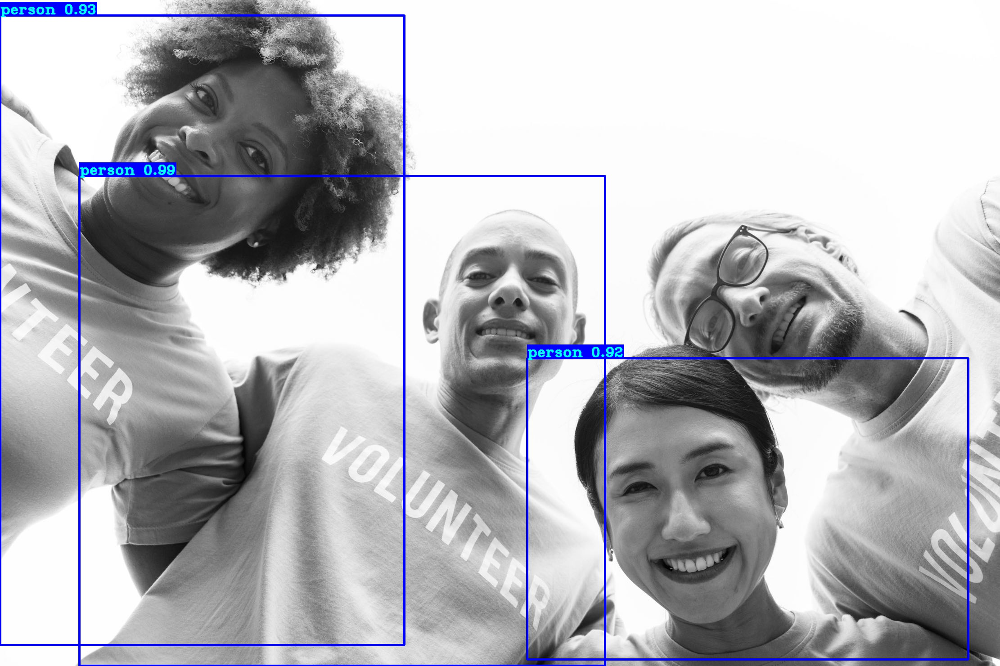

In [ ]:
detectPeopleAndPrint(8)

Image #9
1/1 [==============================] - 3s 3s/step


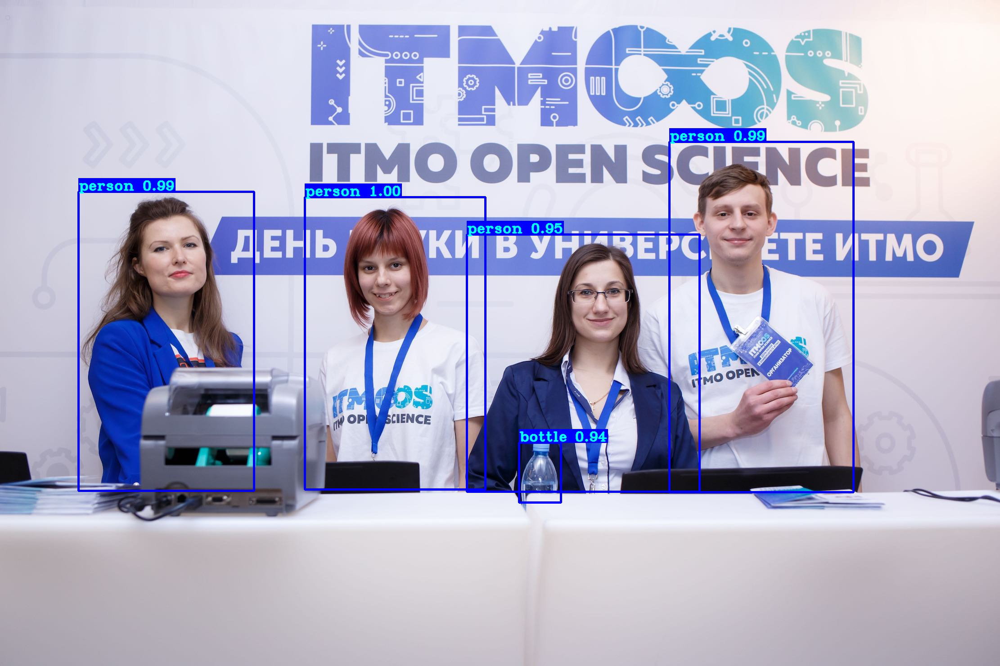

In [ ]:
detectPeopleAndPrint(9)

Image #10
1/1 [==============================] - 3s 3s/step


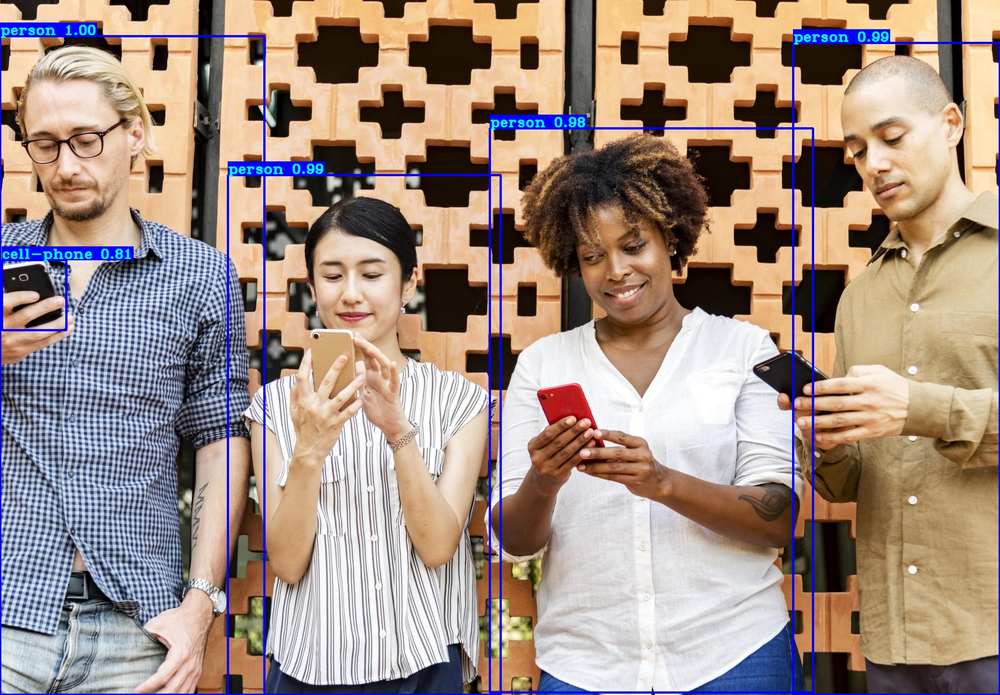

In [ ]:
detectPeopleAndPrint(10)

## 3. Fill in the confusion matrix

While evaluating the performance of the classifier, consider RECOGNIZED PERSONS only. The classifier finds a person in the image when the you see a blue rectangle around the person. The classifier can find other objects (cups, bicycles, laptops, potted flowers, etc.). DISREGARD these recognition results.

Legend:

* TP (True Positive) — the object is correctly classified (i.e. the expert and classifier opinions are the same);
* TN (True Negative) — set this value to zero as there are many objects in the images (not only people), ;
* FP (False Positive) — the classifier evaluates the selected object as a person, but the expert disagrees;
* FN (False Negative) — the expert classifies the selected object as a person, but the classifier doesn’t.

Example 1: There are four persons in the photo. The classifier finds three persons, therefore, TP=3, FN=1, FP=0, TN=0.
Example 2: There are four persons in the photo. The classifier finds six persons (it classifies a bush and traffic light as persons). Thus, TP=4, FP=2, FN=0, TN=0.

IMPORTANT NOTE: If a blue rectangle is drawn around several persons (the frame is big enough and there are several persons in it), you should count the number of items found by the classifier (TP), i.e. the number of blue rectangles drawn by the classifier and the number of persons not foudnd (FN).

YOLO with 50% cutoff threshold

* IMH 1 TP=4, FP=0, FN=0, TN=2
* IMH 2 TP=3, FP=0, FN=1, TN=1
* IMH 3 TP=5, FP=0, FN=0, TN=0
* IMH 4 TP=2, FP=0, FN=2, TN=2
* IMH 5 TP=6, FP=0, FN=0, TN=0
* IMH 6 TP=3, FP=0, FN=0, TN=0
* IMH 7 TP=4, FP=0, FN=0, TN=0
* IMH 8 TP=3, FP=0, FN=1, TN=0
* IMH 9 TP=4, FP=0, FN=0, TN=1
* IMH 10 TP=4, FP=0, FN=0, TN=1

In [ ]:
# TP / (TP + FP)
precision = 38 / (38 + 4)

# TP / (TP + FN)
recall = 38 / (38 + 0)

In [ ]:
#F1
2 * (precision * recall) / (precision + recall)

0.9500000000000001